# Preprocessing and clustering Oliver RPM Data for Network Generation

Going to attempt to analyze data together first, on the same UMAP and Leiden clusters. End goal is to get a series of states for each timepoint that I can binarize and use in Martina's tool, along with finding significant genes to input to MAGINE and get some biological context, possibly leading to rules for adding into Boolean Rule Creator. 

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

## Loading in Data

In [3]:
folders = ['SC39_LB17018', 'SC39_LB17019', 'SC39_LB17020']
path = '/data/'

[SC3918, SC3919, SC3920] = [sc.read_10x_mtx((path + folder)) for folder in folders]
adatas_s = [SC3919, SC3920]
sensitive_adata = SC3918.concatenate(adatas_s)

#'SC55_LB19001'   For some reason this one has text files instead of .mtx format, won't load properly
folders = ['SC16_LB17028','SC16_LB17029', 'SC49_LB17023', 'SC49_LB17024', 'SC49_LB17025','SC55-1_LB17001']

[SC16028, SC16029, SC49023, SC49024, SC49025, SC55] = [sc.read_10x_mtx((path + folder)) for folder in folders]
adatas_r = [SC16029, SC49023, SC49024, SC49025, SC55]
resistant_adata = SC16028.concatenate(adatas_r)

In [36]:
#Sampling this tumor because it has ~40K cells compared to the 1500-5000 found in other tumors
sc.pp.subsample(SC3919, n_obs = 2000)

In [38]:
resistant_adata = SC16028.concatenate(adatas_r, batch_key = 'Resistant', batch_categories=['SC16-1','SC16-2', 'SC49-1', 'SC49-2', 'SC49-3', 'SC55'])
sensitive_adata = SC3918.concatenate(adatas_s, batch_key = 'Sensitive', batch_categories=['SC39-1','SC39-2', 'SC39-3'])

In [41]:
# Concatenating twice so that I can color plots by treatment as well as the individual samples
adata= sensitive_adata.concatenate(resistant_adata, batch_key = 'Treatment', batch_categories=['Sensitive','Resistant'])

In [42]:
# Cutting out low quality reads
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

In [44]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

... storing 'Sensitive' as categorical
... storing 'Resistant' as categorical


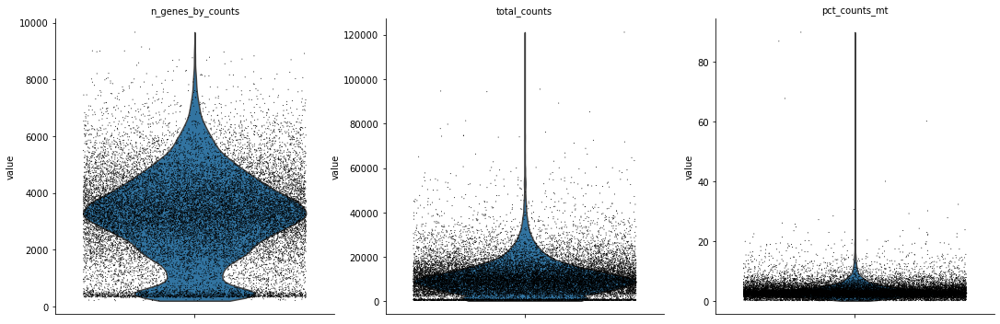

In [45]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

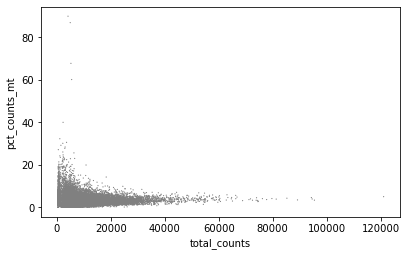

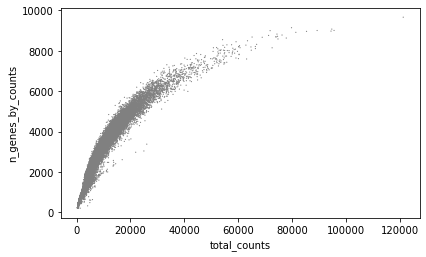

In [46]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [47]:
# Filtering based on graphs above
adata = adata[adata.obs.n_genes_by_counts < 7000, :]
adata = adata[adata.obs.pct_counts_mt < 20, :]

In [49]:
# Log transform and normalization and suggesting in tutorial
sc.pp.log1p(adata)
sc.pp.normalize_total(adata, target_sum=1e4)

C:\Users\perry\anaconda3\envs\scvelo\lib\site-packages\scanpy\preprocessing\_simple.py:373: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [173]:
adata

AnnData object with n_obs × n_vars = 58831 × 24660
    obs: 'batch', 'batch2', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p'

In [50]:
# Using MAGIC to impute gene dropouts in data
sc.external.pp.magic(adata)

  Running MAGIC with `solver='exact'` on 24397-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.


In [52]:
# This preprocessing is done after imputation to account for change in total counts resulting from corrected dropouts
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

In [53]:
# Scale to unit variance for comparible values
sc.pp.scale(adata, max_value=10)

In [54]:
#PCA ran to use top PC's to run UMAP on, in order to speed up computation
sc.tl.pca(adata, svd_solver='arpack')

In [55]:
## Since I have batch keys from two different concatenations, the original sample labels need to be added in for plotting
A = ((adata.obs['Sensitive']).astype(str))
B = ((adata.obs['Resistant']).astype(str))

for i in range(len(A)):
    if A[i] == 'nan':
        A[i] = B[i]

sample = A.astype('category')
adata.obs['Sample'] = sample

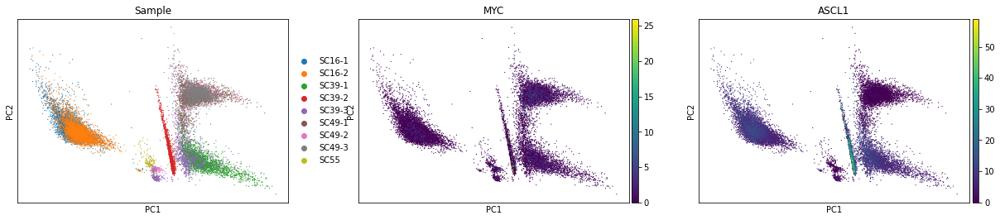

In [56]:
sc.pl.pca(adata, color=['Sample', 'MYC', 'ASCL1'])

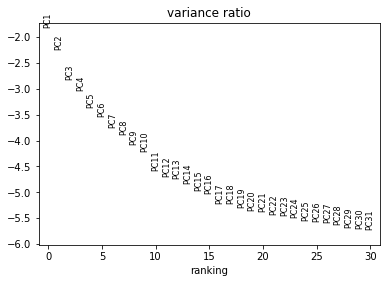

In [57]:
# Since the elbow of the ranking of PCs as a function of variance isn't very defined, I will overcompensate and use a lot of PCs
sc.pl.pca_variance_ratio(adata, log=True)

In [102]:
# Neighborhoods required for UMAP
sc.pp.neighbors(adata, n_neighbors=50, n_pcs=40)
sc.tl.umap(adata)

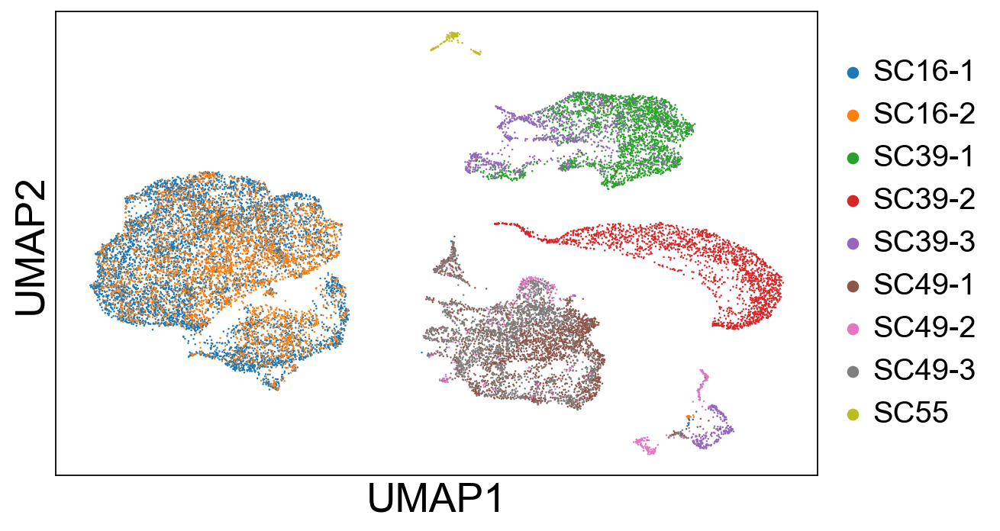

In [134]:
from matplotlib.pyplot import rc_context
sc.set_figure_params(scanpy=True, fontsize=24)
with rc_context({'figure.figsize': (8,5)}):
    sc.pl.umap(adata, color=['Sample'],  legend_fontsize=18, size = 5, title='')


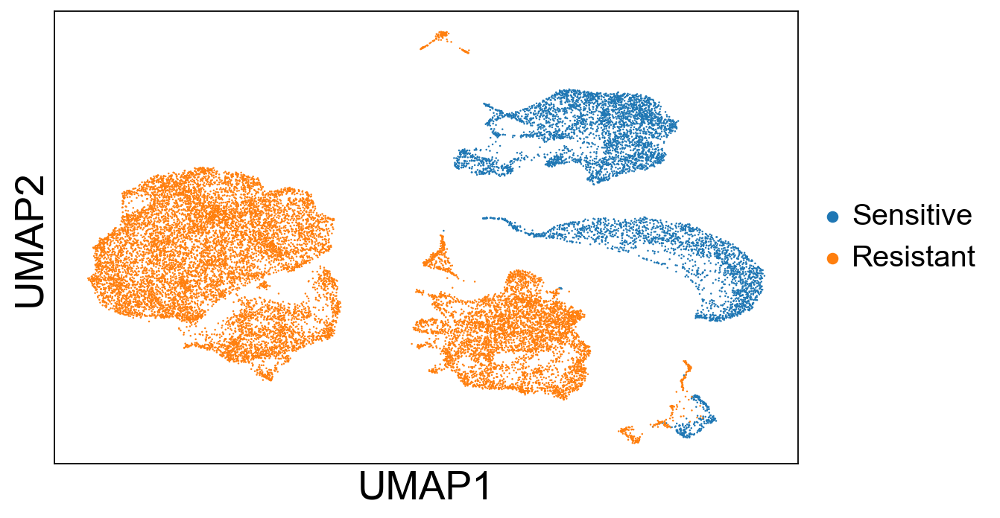

In [133]:
from matplotlib.pyplot import rc_context
sc.set_figure_params(scanpy=True, fontsize=24)
with rc_context({'figure.figsize': (8,5)}):
    sc.pl.umap(adata, color=['Treatment'],  legend_fontsize=18, size = 5, title='')


In [106]:
# Clustering using the Leiden algorithm
sc.tl.leiden(adata)

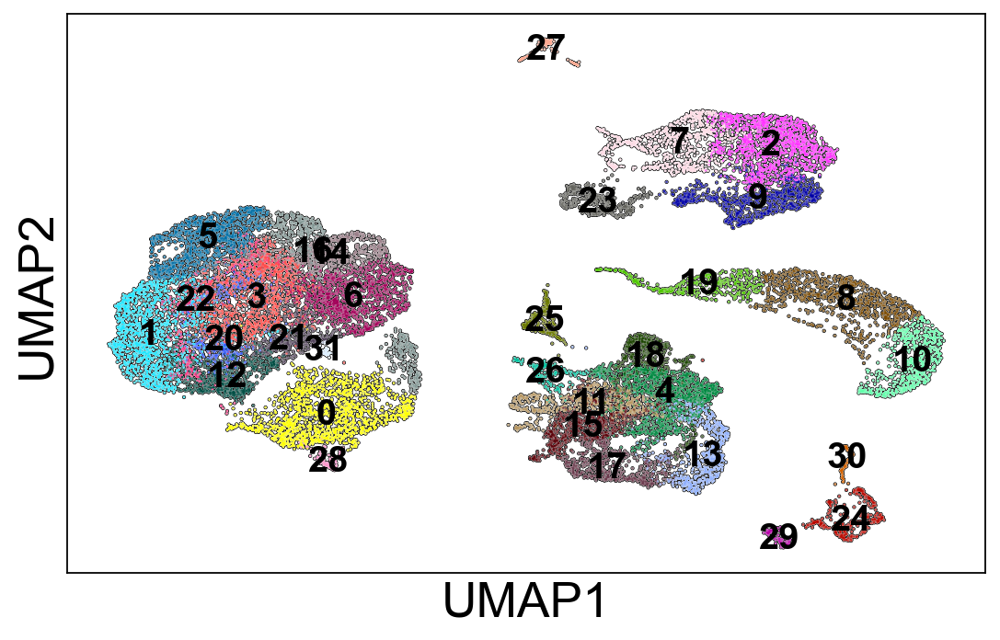

In [113]:
from matplotlib.pyplot import rc_context
sc.set_figure_params(scanpy=True, fontsize=24)
with rc_context({'figure.figsize': (8,5)}):
    sc.pl.umap(adata, color=['leiden'],  legend_loc='on data', legend_fontsize=18,  size = 5, title='',add_outline=True,)

# Differential Gene Expression Analysis

In [115]:
# This loop does DGE for each resistant tumor compared to all of the sensitive tumors, then compiles the top 10 genes from each comparison into the list called r_genes

# Uses this function
def unique(list1):
    unique_list = []
    for x in list1:
        if x not in unique_list:
            unique_list.append(x)
    return(unique_list)

# For resistant genes
r_genes = []
for n in range(len(s_samples)):
    print('Comparing res samples to ' +str(s_samples[n]))
    sc.tl.rank_genes_groups(adata, groupby ='Sample', groups=r_samples, reference=s_samples[n], method='wilcoxon')
    genes_df = pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(10)
    genes_list = (genes_df.stack().reset_index())
    genes_list = genes_list[0]
    genes_unique = unique(genes_list)
    r_genes.append(genes_unique)

Comparing res samples to SC39-1
Comparing res samples to SC39-2
Comparing res samples to SC39-3


In [142]:
# For sensitive genes
s_genes = []
for n in range(len(r_samples)):
    print('Comparing res samples to ' +str(r_samples[n]))
    sc.tl.rank_genes_groups(adata, groupby ='Sample', groups=s_samples, reference=r_samples[n], method='wilcoxon')
    genes_df = pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(10)
    genes_list = (genes_df.stack().reset_index())
    genes_list = genes_list[0]
    genes_unique = unique(genes_list)
    s_genes.append(genes_unique)

In [70]:
r_samples = ['SC16-1','SC16-2', 'SC49-1', 'SC49-2', 'SC49-3', 'SC55']
s_samples = ['SC39-1','SC39-2', 'SC39-3']

In [85]:
# Identifying genes which are found in top 10 ranked differential genes across all comparisons
def intersection(lst1, lst2):
    lst3 = [value for value in lst1 if value in lst2]
    return lst3

overlap_r = set.intersection(*map(set,r_genes))
overlap_s = set.intersection(*map(set,s_genes))

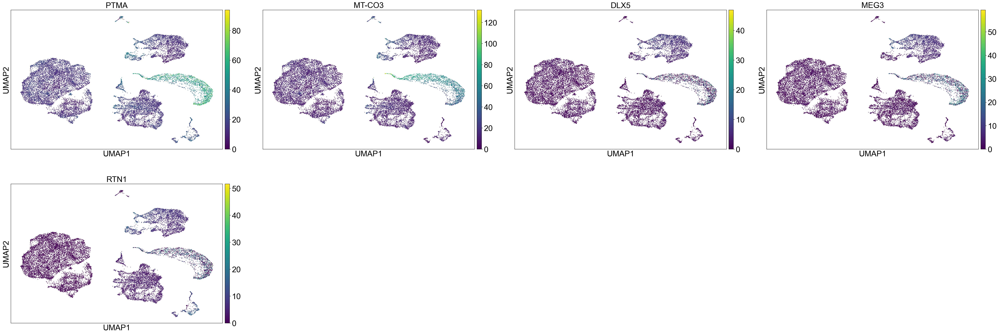

In [86]:
from matplotlib.pyplot import rc_context
sc.set_figure_params(scanpy=True, fontsize=24)
with rc_context({'figure.figsize': (12,8)}):
    sc.pl.umap(adata, color=overlap_s,  legend_fontsize=24,  size = 10)

In [89]:
from matplotlib.pyplot import rc_context
sc.set_figure_params(scanpy=True, fontsize=24)
with rc_context({'figure.figsize': (12,8)}):
    sc.pl.umap(adata, color=overlap_r,  legend_fontsize=24,  size = 10)

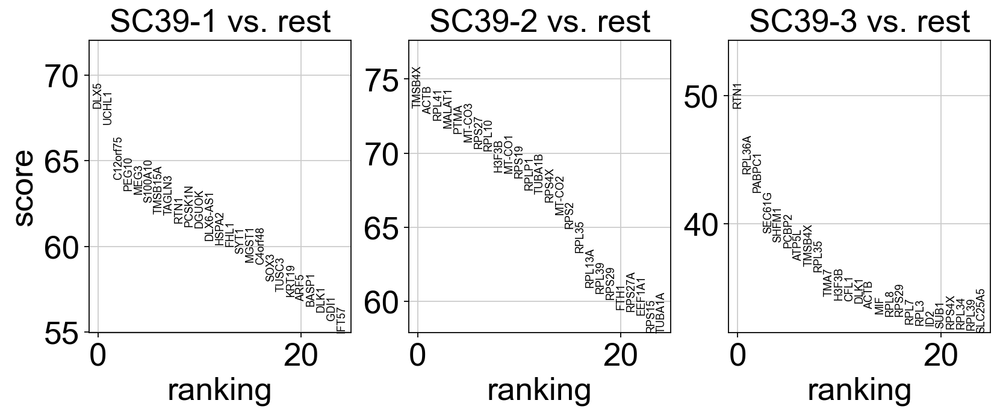

In [88]:
# Example comparison of one resistant tumor (SC39-1) compared to each of the sensitive tumors
# This shows the output of what is happening in the loop above to identify differential genes

sc.tl.rank_genes_groups(adata, groupby ='Sample', groups=s_samples, ref=['SC39-1'], method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

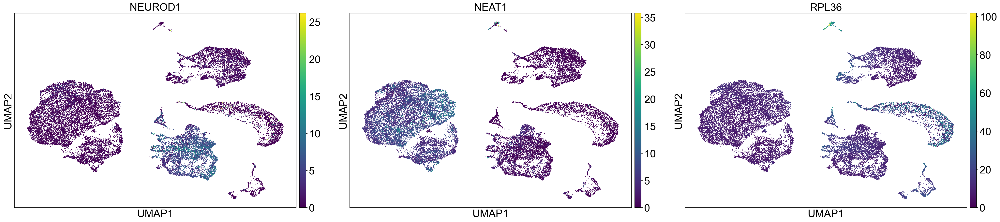

In [137]:
from matplotlib.pyplot import rc_context
sc.set_figure_params(scanpy=True, fontsize=24)
with rc_context({'figure.figsize': (12,8)}):
    sc.pl.umap(adata, color=['NEUROD1', 'NEAT1', 'RPL36'],  legend_fontsize=24,  size = 15)

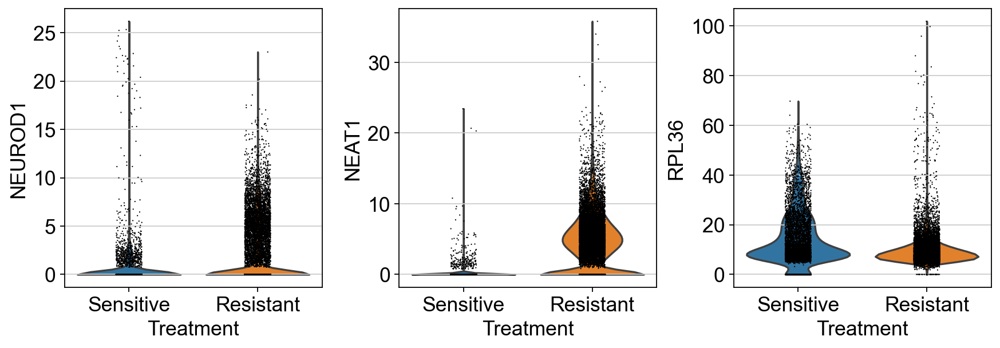

In [136]:
sc.set_figure_params(scanpy=True, fontsize=16)
sc.pl.violin(adata, ['NEUROD1', 'NEAT1', 'RPL36'], groupby='Treatment')

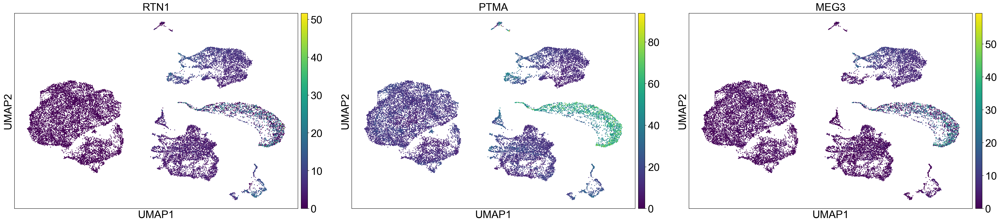

In [138]:
from matplotlib.pyplot import rc_context
sc.set_figure_params(scanpy=True, fontsize=24)
with rc_context({'figure.figsize': (12,8)}):
    sc.pl.umap(adata, color=['RTN1','PTMA', 'MEG3'],  legend_fontsize=24,  size = 15)

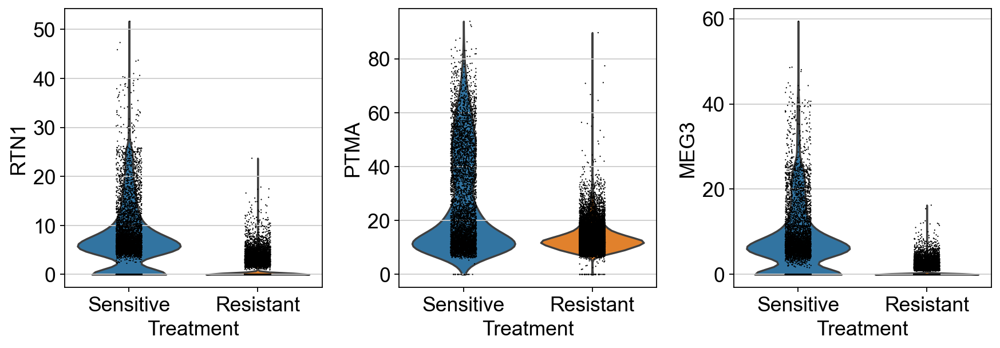

In [130]:
sc.set_figure_params(scanpy=True, fontsize=16)
sc.pl.violin(adata, ['RTN1','PTMA', 'MEG3'], groupby='Treatment')